Extracting Dataset using Kaggle API

In [1]:
# installing the Kaggle library
!pip install kaggle

In [2]:
# configuring the path of Kaggle.json file
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Importing the Dog vs Cat Dataset from Kaggle

In [3]:
# Kaggle api
!kaggle competitions download -c dogs-vs-cats

 99% 801M/812M [00:03<00:00, 252MB/s]
100% 812M/812M [00:03<00:00, 272MB/s]


In [ ]:
!ls

kaggle.json  microsoft-catsvsdogs-dataset.zip  sample_data


In [4]:
# extracting the compressed dataset
from zipfile import ZipFile

dataset = '/content/dogs-vs-cats.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [5]:
# extracting the compressed dataset
from zipfile import ZipFile

dataset = '/content/train.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [6]:
import os
# counting the number of files in train folder
path, dirs, files = next(os.walk('/content/train'))
file_count = len(files)
print('Number of images: ', file_count)

Number of images:  25000


Printing the name of images

Importing the Dependencies

In [9]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
from google.colab.patches import cv2_imshow

Displaying the images of dogs and cats

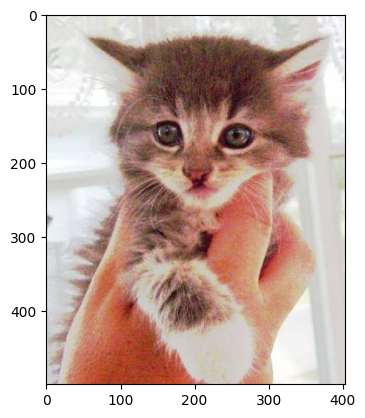

In [10]:
# display cat image
img = mpimg.imread('/content/train/cat.100.jpg')
imgplt = plt.imshow(img)
plt.show()

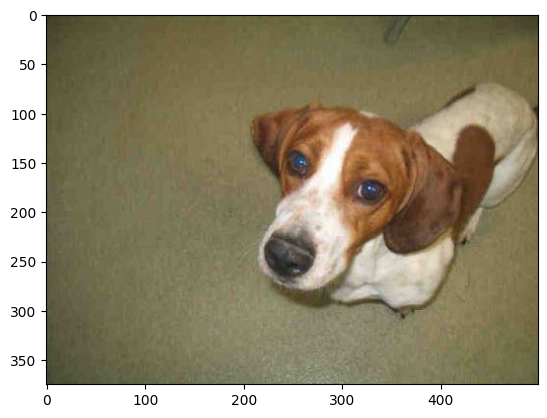

In [11]:
# display dog image
img = mpimg.imread('/content/train/dog.4190.jpg')
imgplt = plt.imshow(img)
plt.show()

In [12]:
import os
file_names = os.listdir('/content/train/')

for i in range(5):

  name = file_names[i]
  print(name[0:3])



dog
cat
dog
dog
dog


In [13]:
file_names = os.listdir('/content/train/')

dog_count = 0
cat_count = 0

for img_file in file_names:

  name = img_file[0:3]

  if name == 'dog':
    dog_count += 1

  else:
    cat_count += 1

print('Number of dog images =', dog_count)
print('Number of cat images =', cat_count)

Number of dog images = 12500
Number of cat images = 12500


Resizing all the images

In [14]:
#creating a directory for resized images
os.mkdir('/content/image resized')

In [17]:
original_folder = '/content/train/'
resized_folder = '/content/image resized/'

for i in range(2000):

  filename = os.listdir(original_folder)[i]
  img_path = original_folder+filename

  img = Image.open(img_path)
  img = img.resize((224, 224))
  img = img.convert('RGB')

  newImgPath = resized_folder+filename
  img.save(newImgPath)

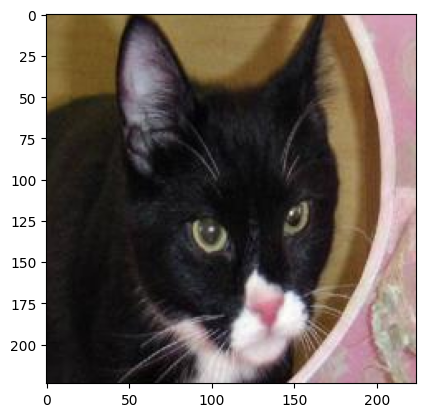

In [20]:
# display resized cat image
img = mpimg.imread('/content/image resized/cat.10001.jpg')
imgplt = plt.imshow(img)
plt.show()

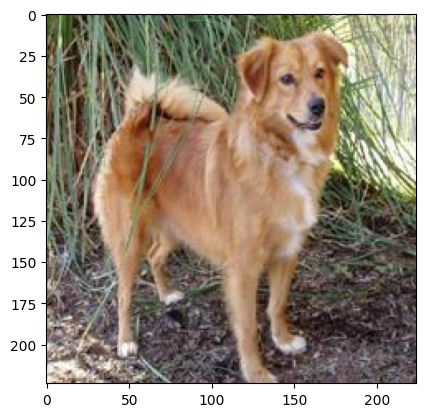

In [21]:
# display resized dog image
img = mpimg.imread('/content/image resized/dog.10003.jpg')
imgplt = plt.imshow(img)
plt.show()

**Creating labels for resized images of dogs and cats**

Cat --> 0

Dog --> 1

In [22]:
# creaing a for loop to assign labels
filenames = os.listdir('/content/image resized/')


labels = []

for i in range(2000):

  file_name = filenames[i]
  label = file_name[0:3]

  if label == 'dog':
    labels.append(1)

  else:
    labels.append(0)

In [23]:
print(filenames[0:5])
print(len(filenames))

['dog.7486.jpg', 'cat.8451.jpg', 'dog.4190.jpg', 'dog.6675.jpg', 'dog.8568.jpg']
2000


In [24]:
print(labels[0:5])
print(len(labels))

[1, 0, 1, 1, 1]
2000


In [25]:
# counting the images of dogs and cats out of 2000 images
values, counts = np.unique(labels, return_counts=True)
print(values)
print(counts)

[0 1]
[ 985 1015]


Converting all the resized images to numpy arrays

In [26]:
import cv2
import glob

In [27]:
image_directory = '/content/image resized/'
image_extension = ['png', 'jpg']

files = []

[files.extend(glob.glob(image_directory + '*.' + e)) for e in image_extension]

dog_cat_images = np.asarray([cv2.imread(file) for file in files])

In [28]:
print(dog_cat_images)

[[[[170 168 168]
   [169 167 167]
   [169 167 167]
   ...
   [167 165 165]
   [166 164 164]
   [165 163 163]]

  [[176 174 174]
   [175 173 173]
   [173 171 171]
   ...
   [163 161 161]
   [166 164 164]
   [168 166 166]]

  [[179 177 177]
   [177 175 175]
   [174 172 172]
   ...
   [161 159 159]
   [163 161 161]
   [164 162 162]]

  ...

  [[157 155 155]
   [152 150 150]
   [157 155 155]
   ...
   [148 151 172]
   [140 144 172]
   [131 134 165]]

  [[137 135 135]
   [131 129 129]
   [139 137 137]
   ...
   [134 136 167]
   [123 124 162]
   [108 110 151]]

  [[145 143 143]
   [135 133 133]
   [140 138 138]
   ...
   [113 115 150]
   [105 104 148]
   [ 93  93 141]]]


 [[[141 158 184]
   [137 154 180]
   [133 150 176]
   ...
   [137 138 134]
   [138 139 135]
   [138 139 135]]

  [[141 158 184]
   [138 155 181]
   [134 151 177]
   ...
   [137 138 134]
   [137 138 134]
   [137 138 134]]

  [[141 158 184]
   [137 154 180]
   [133 150 176]
   ...
   [136 137 133]
   [136 137 133]
   [136 137

In [29]:
type(dog_cat_images)

numpy.ndarray

In [30]:
print(dog_cat_images.shape)

(2000, 224, 224, 3)


In [31]:
X = dog_cat_images
Y = np.asarray(labels)

**Train Test Split**

In [32]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=2)

In [33]:
print(X.shape, X_train.shape, X_test.shape)

(2000, 224, 224, 3) (1600, 224, 224, 3) (400, 224, 224, 3)


1600 --> training images

400 --> test images

In [34]:
# scaling the data
X_train_scaled = X_train/255

X_test_scaled = X_test/255

In [35]:
print(X_train_scaled)

[[[[0.00392157 0.01176471 0.01568627]
   [0.         0.         0.00392157]
   [0.         0.         0.00392157]
   ...
   [0.03529412 0.07058824 0.08627451]
   [0.02352941 0.05882353 0.0745098 ]
   [0.02745098 0.0627451  0.07843137]]

  [[0.00392157 0.01176471 0.01568627]
   [0.         0.         0.00392157]
   [0.         0.         0.00392157]
   ...
   [0.04705882 0.08235294 0.09803922]
   [0.03137255 0.06666667 0.08235294]
   [0.03529412 0.07058824 0.08627451]]

  [[0.00392157 0.01176471 0.01568627]
   [0.         0.         0.00392157]
   [0.         0.         0.00392157]
   ...
   [0.0627451  0.09803922 0.11372549]
   [0.04705882 0.08235294 0.09803922]
   [0.04705882 0.08235294 0.09803922]]

  ...

  [[0.04313725 0.         0.        ]
   [0.04705882 0.         0.00392157]
   [0.04313725 0.         0.00784314]
   ...
   [0.01568627 0.02745098 0.01960784]
   [0.01960784 0.03137255 0.02352941]
   [0.02352941 0.03529412 0.02745098]]

  [[0.0627451  0.01568627 0.01568627]
   [0.0

**Building the Neural Network**

In [36]:
import tensorflow as tf
import tensorflow_hub as hub

In [37]:
mobilenet_model = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4'

pretrained_model = hub.KerasLayer(mobilenet_model, input_shape=(224,224,3), trainable=False)

In [39]:
num_of_classes = 2

model = tf.keras.Sequential([
    tf.keras.layers.Lambda(lambda x: pretrained_model(x)),
    tf.keras.layers.Dense(num_of_classes)
])

model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda (Lambda)                 │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [40]:
model.compile(
    optimizer = 'adam',
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics = ['acc']
)

In [41]:
model.fit(X_train_scaled, Y_train, epochs=5)

Epoch 1/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 60s 1s/step - acc: 0.8106 - loss: 0.4041
Epoch 2/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - acc: 0.9755 - loss: 0.0873
Epoch 3/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 54s 1s/step - acc: 0.9884 - loss: 0.0500
Epoch 4/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - acc: 0.9913 - loss: 0.0414
Epoch 5/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 51s 1s/step - acc: 0.9953 - loss: 0.0315


In [42]:
score, acc = model.evaluate(X_test_scaled, Y_test)
print('Test Loss =', score)
print('Test Accuracy =', acc)

13/13 ━━━━━━━━━━━━━━━━━━━━ 14s 1s/step - acc: 0.9746 - loss: 0.0737  
Test Loss = 0.05993367359042168
Test Accuracy = 0.9800000190734863


**Predictive System**

Path of the image to be predicted: /content/cat_image.jpeg


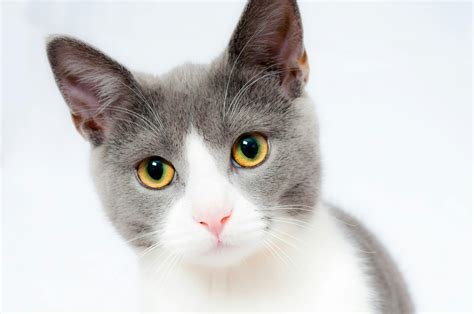

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
[[ 3.845824 -6.132844]]
0
The image represents a Cat


In [43]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')

Path of the image to be predicted: /content/dog_image.jpg


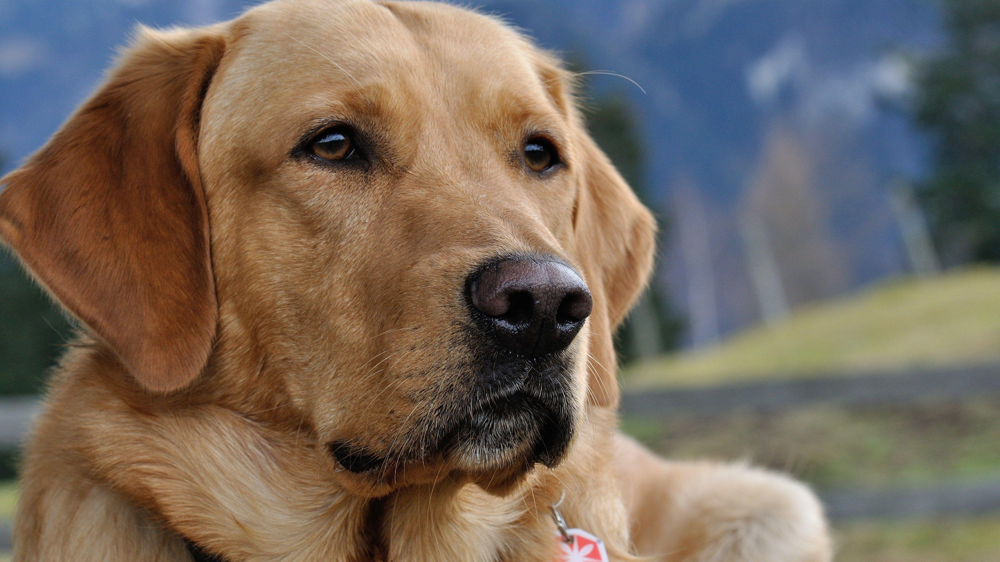

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
[[-4.7382836  3.8512614]]
1
The image represents a Dog


In [44]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')